In [1]:
import matplotlib.pyplot as plt 
import pandas as pd
import seaborn as sns
import cufflinks as cd
import plotly.express as px
import numpy as np
import plotly.offline as pyo
from math import radians, cos, sin, asin, sqrt
pyo.init_notebook_mode()
%matplotlib inline

In [2]:
data_train = pd.read_csv("Data/fraudTrain.csv")
data_test = pd.read_csv("Data/fraudTest.csv")

data = pd.concat([data_train,data_test], axis = 0)

data['trans_date_trans_time'] = pd.to_datetime(data['trans_date_trans_time'])
data['hour'] = data['trans_date_trans_time'].dt.hour

data['day_of_week'] = data['trans_date_trans_time'].dt.day_name()

data['year_month'] = data['trans_date_trans_time'].dt.to_period('M')

data['dob'] = pd.to_datetime(data['dob'])
data['age'] = np.round((data['trans_date_trans_time'] - data['dob'])/np.timedelta64(1,'Y'))

data['year_month'] = data['year_month'].astype("str")

In [3]:
def distance(lat1, lat2, lon1, lon2):
     
    # The math module contains a function named
    # radians which converts from degrees to radians.
    lon1 = np.radians(lon1)
    lon2 = np.radians(lon2)
    lat1 = np.radians(lat1)
    lat2 = np.radians(lat2)
      
    # Haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
 
    c = 2 * asin(sqrt(a))
    
    # Radius of earth in kilometers. Use 3956 for miles
    r = 6371
      
    # calculate the result
    return(c * r)

data['dist'] = data.apply(lambda x: distance(x.merch_lat, x.lat, x.merch_long, x.long), axis=1)

In [4]:
data.drop('Unnamed: 0', axis = 1, inplace = True)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1852394 entries, 0 to 555718
Data columns (total 27 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   trans_date_trans_time  datetime64[ns]
 1   cc_num                 int64         
 2   merchant               object        
 3   category               object        
 4   amt                    float64       
 5   first                  object        
 6   last                   object        
 7   gender                 object        
 8   street                 object        
 9   city                   object        
 10  state                  object        
 11  zip                    int64         
 12  lat                    float64       
 13  long                   float64       
 14  city_pop               int64         
 15  job                    object        
 16  dob                    datetime64[ns]
 17  trans_num              object        
 18  unix_time              

In [6]:
data.isnull().sum()

trans_date_trans_time    0
cc_num                   0
merchant                 0
category                 0
amt                      0
first                    0
last                     0
gender                   0
street                   0
city                     0
state                    0
zip                      0
lat                      0
long                     0
city_pop                 0
job                      0
dob                      0
trans_num                0
unix_time                0
merch_lat                0
merch_long               0
is_fraud                 0
hour                     0
day_of_week              0
year_month               0
age                      0
dist                     0
dtype: int64

In [7]:
data.describe()

,cc_num,amt,zip,lat,long,city_pop,unix_time,merch_lat,merch_long,is_fraud,hour,age,dist
count,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06,1.852394e+06
mean,4.173860e+17,7.006357e+01,4.881326e+04,3.853931e+01,-9.022783e+01,8.864367e+04,1.358674e+09,3.853898e+01,-9.022794e+01,5.210015e-03,1.280612e+01,4.626617e+01,7.611173e+01
std,1.309115e+18,1.592540e+02,2.688185e+04,5.071470e+00,1.374789e+01,3.014876e+05,1.819508e+07,5.105604e+00,1.375969e+01,7.199217e-02,6.815753e+00,1.741239e+01,2.911697e+01
min,6.041621e+10,1.000000e+00,1.257000e+03,2.002710e+01,-1.656723e+02,2.300000e+01,1.325376e+09,1.902742e+01,-1.666716e+02,0.000000e+00,0.000000e+00,1.400000e+01,2.225452e-02
25%,1.800429e+14,9.640000e+00,2.623700e+04,3.466890e+01,-9.679800e+01,7.410000e+02,1.343017e+09,3.474012e+01,-9.689944e+01,0.000000e+00,7.000000e+00,3.300000e+01,5.532009e+01
50%,3.521417e+15,4.745000e+01,4.817400e+04,3.935430e+01,-8.747690e+01,2.443000e+03,1.357089e+09,3.936890e+01,-8.744069e+01,0.000000e+00,1.400000e+01,4.400000e+01,7.821638e+01
75%,4.642255e+15,8.310000e+01,7.204200e+04,4.194040e+01,-8.015800e+01,2.032800e+04,1.374581e+09,4.195626e+01,-8.024511e+01,0.000000e+00,1.900000e+01,5.700000e+01,9.850947e+01
max,4.992346e+18,2.894890e+04,9.992100e+04,6.669330e+01,-6.795030e+01,2.906700e+06,1.388534e+09,6.751027e+01,-6.695090e+01,1.000000e+00,2.300000e+01,9.600000e+01,1.521172e+02


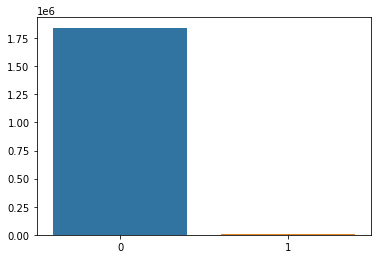

In [8]:
ax = sns.barplot(x = data.is_fraud.value_counts().keys(),y = data.is_fraud.value_counts().tolist())

The classes are very imbalanced, we have to perform under sampling or over sampling in order to balance the classes

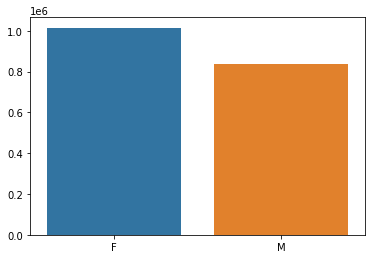

In [9]:
ax = sns.barplot(x = data.gender.value_counts().keys(),y = data.gender.value_counts().tolist())

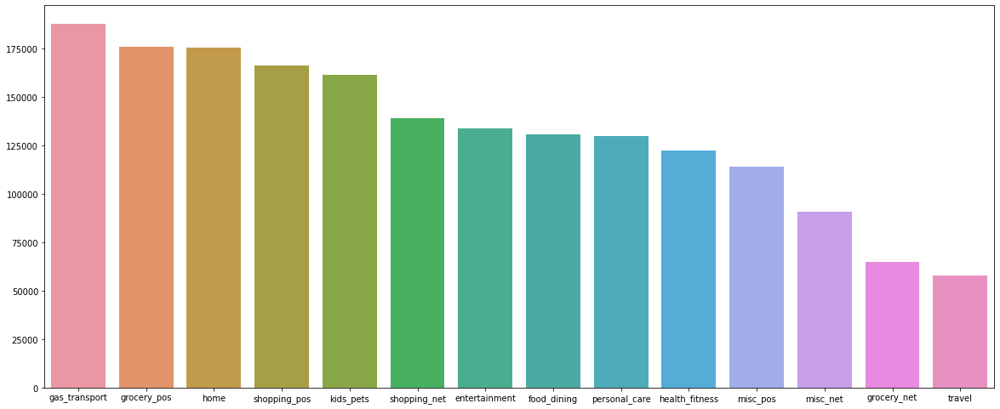

In [10]:
a4_dims = (20, 8.27)
fig, ax = plt.subplots(figsize=a4_dims)
ax = sns.barplot(x = data.category.value_counts().keys(),y = data.category.value_counts().tolist())

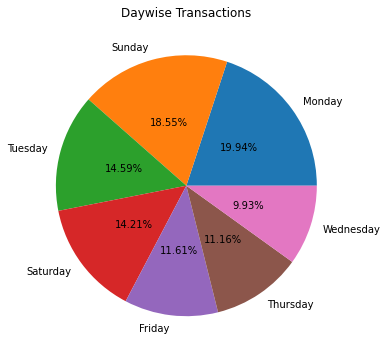

In [11]:
pie, ax = plt.subplots(figsize=[10,6])
labels = data.day_of_week.value_counts().keys()
plt.pie(x=data.day_of_week.value_counts().values, autopct="%.2f%%", labels=labels, pctdistance=0.5)
plt.title("Daywise Transactions")
plt.show()

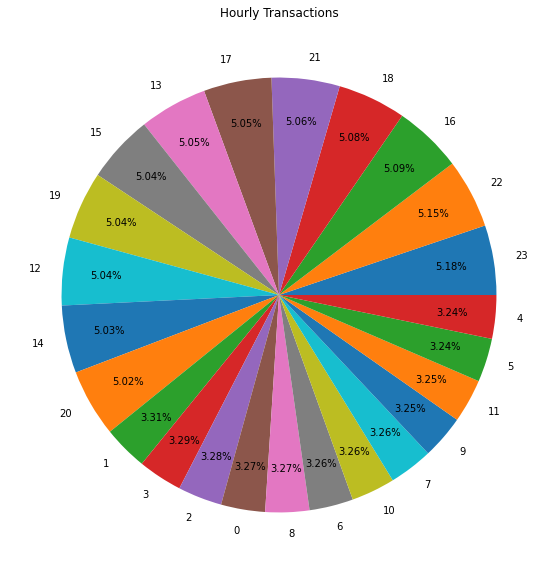

In [12]:
pie, ax = plt.subplots(figsize=[20,10])
labels = data.hour.value_counts().keys()
plt.pie(x=data.hour.value_counts().values, autopct="%.2f%%", labels=labels, pctdistance=0.8)
plt.title("Hourly Transactions")
plt.show()

In [13]:
fig = px.histogram(data,x = 'age',nbins = 10, histnorm = 'percent')
pyo.iplot(fig, filename = 'Age-Hist')

Majority of the customers are 20-60 years old

In [14]:
data_fraud = data[data['is_fraud'] == 1]
fig1 = px.choropleth(data_fraud.state,locations=data_fraud.state.value_counts().keys(),
                     locationmode="USA-states",
                     color=data_fraud.state.value_counts().tolist(),
                     color_continuous_scale="deep",
                     scope="usa",
                     hover_name=data_fraud.state.unique(),
                     labels={"color":"#Transactions"}
                    )

#fig1.show()
pyo.iplot(fig1)

In [15]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Scattergeo(
        lon = data[data['is_fraud']  == 1]['long'],
        lat = data[data['is_fraud']  == 1]['lat'],
        mode = 'markers',
        ))

fig.update_layout(
        title = 'Location of Cutomer at the time of Fraud Transaction',
        geo_scope='usa',
    )
pyo.iplot(fig)

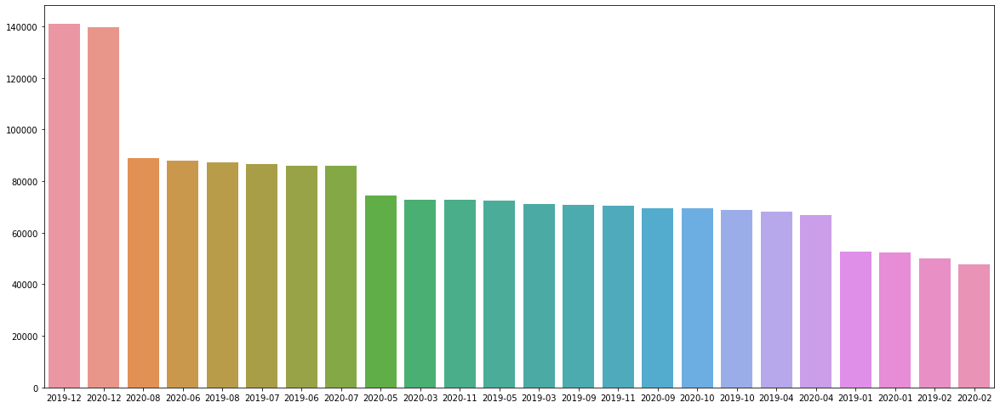

In [16]:
a4_dims = (20, 8.27)
fig, ax = plt.subplots(figsize=a4_dims)
ax = sns.barplot(x = data.year_month.value_counts().keys(),y = data.year_month.value_counts().tolist())

During Festival sesaon (Christmas) the number of transaction are very high

In [ ]:
#fig = px.density_heatmap(data, x="gender", y="state", z="is_fraud",color_continuous_scale="Greens")
#fig.show()

![alt text](Pictures/State_heat.png "Title")

The number of fraud cases of both male and female are highest in New York

In [ ]:
#fig = px.density_heatmap(data, x="day_of_week", y="hour", z="is_fraud",color_continuous_scale="Greens")
#fig.show()

![alt text](Pictures/Day_Fraud.png "Title")

Number of late night frauds are very high during full week

In [17]:
fig = px.histogram(data[data['is_fraud'] == 1],x = 'dist',nbins = 100, histnorm = 'percent')
pyo.iplot(fig)

Fraud cases increases as distances increases and after 

<AxesSubplot:xlabel='amt', ylabel='is_fraud'>

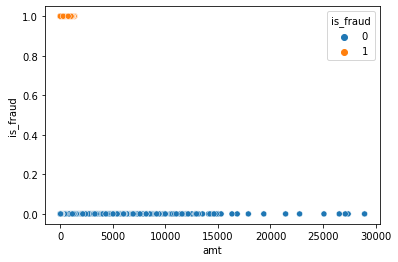

In [18]:
sns.scatterplot(x = data['amt'], y = data['is_fraud'],
               hue = data['is_fraud'])

Fraud amt is very less as compared to the range of the amt